In [1]:
import numpy as np
import pandas as pd
import scipy.stats as ss
import datetime as dt

In [2]:
import plotly
import plotly.express as px

import plotly.graph_objs as go
from plotly.subplots import make_subplots


plotly.offline.init_notebook_mode(connected=True)

In [3]:
def PlotData(df):
    pdata = [{'x':df.index,'y':df[col],'name':col} for col in df.columns]
    return(pdata)

## Getting the data

***No need to run if you want to read the existing pickled DataFrame***

In [4]:
# Optional, if you have to get data from Yahoo Finance
import yfinance as yf

yDF = yf.download(tickers = "IVV IWM EFA EEM AGG HYG",period = "max",interval = "1mo",
        group_by = 'ticker',auto_adjust = True,prepost = True)

# Keeping only the Close prices
ColList = [(ticker,'Close') for ticker in yDF.columns.levels[0]]
Prices = yDF[ColList]

# Simplifying the column names from multiindex to a one-level index
Prices.columns = Prices.columns.levels[0]

DatesToDrop = [dt.datetime(2019,6,3),dt.datetime(2019,8,12)] # All NaN and non mont-end
Prices = Prices.drop(index = DatesToDrop)

Prices.to_pickle('ETF_Prices.pkl')

[*********************100%***********************]  6 of 6 downloaded


## Prices and returns

In [5]:
Prices = pd.read_pickle('ETF_Prices.pkl')
Returns = Prices.pct_change()            # Converts prices to returns

In [6]:
# Plotting price levels
pdata = PlotData(Prices)
layout = go.Layout(title = dict(text='ETF Prices',xref="paper",x=0.5),
                   yaxis=dict(tickformat='.1f',title='Price'))

pFig = go.Figure(pdata,layout)

plotly.offline.iplot(pFig)

### Cumulative returns

In [7]:
# Cumulative returns can look very different with different starting points

# Create cumulative returns, convert frames to long form 
CumRets1 = Returns.transform(lambda x: (1+x).cumprod()-1)
CumRets1 = pd.melt(CumRets1.reset_index(),id_vars='Date', var_name='ETF',value_name='CumRet')
CumRets1['StartDate'] = CumRets1['Date'][0].strftime('%B %-d, %Y')

StartDate = '2009-03-01'
CumRets2 = Returns.loc[StartDate:None].transform(lambda x: (1+x).cumprod()-1)
CumRets2 = pd.melt(CumRets2.reset_index(),id_vars='Date', var_name='ETF',value_name='CumRet')
CumRets2['StartDate'] = CumRets2['Date'][0].strftime('%B %-d, %Y')

# Stack them for convenient plotting with plotly express
CR = pd.concat([CumRets1,CumRets2])


In [8]:
# Plotting is particularly easy with plotly express

fig = px.line(CR,x='Date',y='CumRet',color='ETF',facet_col='StartDate')
fig.update_layout(title='ETF Returns',
                  yaxis=dict(title='Cumulative Return',tickformat='%.1'))

## Overall correlation

In [9]:
# Overall correlation
Returns.corr()

,HYG,IVV,EEM,EFA,IWM,AGG
HYG,1.000000,0.720186,0.703837,0.731537,0.703979,0.372059
IVV,0.720186,1.000000,0.782365,0.876634,0.892069,0.027578
EEM,0.703837,0.782365,1.000000,0.875965,0.722517,0.157535
EFA,0.731537,0.876634,0.875965,1.000000,0.762212,0.151330
IWM,0.703979,0.892069,0.722517,0.762212,1.000000,-0.048162
AGG,0.372059,0.027578,0.157535,0.151330,-0.048162,1.000000


## Rolling correlations

In [10]:
# Rolling Correlations
RCorr = Returns.rolling(12).corr(pairwise=True) # Really nice syntax!
RCorr.tail()

HYG       IVV       EEM       EFA       IWM       AGG
Date                                                                      
2019-08-01 IVV  0.890703  1.000000  0.845653  0.979240  0.974675 -0.339473
           EEM  0.875360  0.845653  1.000000  0.887445  0.840990 -0.078597
           EFA  0.935250  0.979240  0.887445  1.000000  0.975241 -0.289757
           IWM  0.882706  0.974675  0.840990  0.975241  1.000000 -0.401054
           AGG  0.020621 -0.339473 -0.078597 -0.289757 -0.401054  1.000000

In [11]:
RC2 = RCorr.reset_index().rename(columns={'level_1':'ETF'})
RC2 = pd.melt(RC2,id_vars=['Date','ETF'],var_name='With',value_name='Corr')
RC2.tail()

,Date,ETF,With,Corr
10687,2019-08-01,IVV,AGG,-0.339473
10688,2019-08-01,EEM,AGG,-0.078597
10689,2019-08-01,EFA,AGG,-0.289757
10690,2019-08-01,IWM,AGG,-0.401054
10691,2019-08-01,AGG,AGG,1.000000


In [12]:
px.line(RC2,x='Date',y='Corr',color='With',facet_col='ETF')

## Multivariate normal sample

### Means

In [13]:
# Means from historical data are poor estimates of future mean returns, but plotting
# historical rolling means can give us a sense of orders of magnitude

Rmeans = Returns.rolling(120).mean()
Rmeans = pd.melt(Rmeans.reset_index(),id_vars='Date',var_name='ETF',value_name='RMean')
Rmeans.tail()
px.line(Rmeans,x='Date',y='RMean',color='ETF').update_layout(
    yaxis=dict(tickformat='.2%'))

,Date,ETF,RMean
1777,2019-04-01,AGG,0.001416
1778,2019-05-01,AGG,0.001575
1779,2019-06-01,AGG,0.001560
1780,2019-07-01,AGG,0.001598
1781,2019-08-01,AGG,0.001766


In [14]:
condition = Rmeans['Date'] == dt.datetime(2019,8,1)
tmp = Rmeans[condition]
mu = pd.Series(np.array(tmp['RMean']),index=np.array(tmp['ETF']))  # only arrays work

#mu = (0.4/100)*np.ones(len(Returns.columns))

### Covariance
*For the pandas covariance calculation, the handling of missing values is not documented 
clearly, but seems to drop missing value rows separately for each pair of variables. This 
matches the 'partialrows'(MATLAB) or 'pairwise' (R) option. See this [discussion]( https://github.com/pandas-dev/pandas/issues/16837)*

In [15]:
sigma = Returns.cov() # Really nice syntax
sigma

,HYG,IVV,EEM,EFA,IWM,AGG
HYG,0.000770,0.000748,0.001104,0.000928,0.000941,0.000100
IVV,0.000748,0.001177,0.001479,0.001277,0.001398,0.000009
EEM,0.001104,0.001479,0.003037,0.002050,0.001818,0.000082
EFA,0.000928,0.001277,0.002050,0.001803,0.001478,0.000060
IWM,0.000941,0.001398,0.001818,0.001478,0.002373,-0.000021
AGG,0.000100,0.000009,0.000082,0.000060,-0.000021,0.000088


### Sampling

In [16]:
     
s1 = ss.multivariate_normal.rvs(mean=mu,cov=sigma,size=120)

s1.shape
s1[0:4,0:7]

(120, 6)

array([[-0.02369414,  0.0090073 , -0.012249  ,  0.00273229,  0.01390949,
        -0.00396338],
       [ 0.00012601, -0.01483693,  0.0012301 , -0.02316253,  0.0174388 ,
         0.00830747],
       [-0.01823251,  0.01545516,  0.02048005,  0.01809664, -0.00398573,
        -0.00654832],
       [ 0.04903879,  0.04916162,  0.06038025,  0.0534958 ,  0.07713768,
         0.00952649]])

## Simulations with rebalancing

### Generating scenario returns 

In [17]:
# Monthly returns with 1000 scenarios for a 10 year horizon. Takes about 11 s.

import time
# Parameters
nAssets = len(Returns.columns)

TRebal = 3                           # Rebalance once every TRebal months
THorizon = int(10*12)                # in months; 10 year horizon
NRebal = int(THorizon/TRebal)        # Number of rebalancings

NominalValue = 1
wTarget = np.ones(nAssets)/nAssets 

np.random.seed(123456)
NScenarios = 1000                   # Each scenario consists of THorizon monthly returns

start = time.time()
res = np.zeros((NScenarios*THorizon,3))
counter = 0
for i in range(NScenarios):
    Rsim = (1+ ss.multivariate_normal.rvs(mean=mu,cov=sigma,size=THorizon))  # Simulated (1+r)
    Vt = wTarget*NominalValue
    for j in range(THorizon):        
        Vt = Vt * Rsim[j,:]       # Growth of values        
        if np.mod(j,TRebal)==0:
            Vt = wTarget * sum(Vt)          # Rebalancing
        res[counter,:] = np.array([i,j,sum(Vt)])
        counter += 1
    
ResDF = pd.DataFrame(res,columns=['Scenario','Month','Vt'])
end = time.time()
print(end-start)

12.730559825897217


In [18]:
# Monthly returns, algo 2: calls multivariate_normal before the loops.Takes about 9.2 s.

import time
# Parameters
nAssets = len(Returns.columns)

TRebal = 3                           # Rebalance once every TRebal months
THorizon = int(10*12)                # in months; 10 year horizon
NRebal = int(THorizon/TRebal)        # Number of rebalancings

NominalValue = 1
wTarget = np.ones(nAssets)/nAssets 

np.random.seed(123456)
NScenarios = 1000                   # Each scenario consists of THorizon monthly returns

NMonths = NScenarios*THorizon
res = np.zeros((NMonths,3))

start = time.time()
Rsim = (1+ ss.multivariate_normal.rvs(mean=mu,cov=sigma,size=NMonths))  # Simulated (1+r)   
counter = 0
for i in range(NScenarios):    
    Vt = wTarget*NominalValue
    for j in range(THorizon):        
        Vt = Vt * Rsim[counter,:]                 # Growth of values        
        if np.mod(j,TRebal)==0:
            Vt = wTarget * sum(Vt)               # Rebalancing
        res[counter,:] = np.array([i,j,sum(Vt)])
        counter += 1
    
ResDF = pd.DataFrame(res,columns=['Scenario','Month','Vt'])
end = time.time()
print(end-start)

9.92449426651001


In [19]:
ResDF[['Scenario','Month']] = ResDF[['Scenario','Month']].astype('int')
ResDF.head()

,Scenario,Month,Vt
0,0,0,0.990759
1,0,1,0.988705
2,0,2,0.971947
3,0,3,0.968455
4,0,4,0.963211


### Plotting scenario returns

In [20]:
# plotly.express, contrary to its name, is too slow. Takes 122 s.
# start=time.time()
# px.line(ResDF,x='Month',y='Vt',color='Scenario').update_layout(showlegend=False)
# end=time.time()
# print(end-start)

122.39033579826355


In [21]:
Test = ResDF.pivot(index='Month',columns='Scenario',values='Vt')
Test.head()
                   

Scenario,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
Month,,,,,,,,,,,,,,,,,,,,,
0,0.990759,0.955901,0.985102,0.996658,0.950058,1.019382,0.979903,1.034414,1.044960,0.988216,...,1.012619,1.012524,0.995618,0.991624,1.028170,1.022468,1.033771,0.999987,0.985217,0.941211
1,0.988705,0.952803,0.994916,1.003685,0.949629,1.009082,1.009580,1.005963,1.015621,0.961230,...,1.008022,1.041040,0.971783,1.023790,0.995550,1.019546,1.061876,1.005288,0.972340,0.904679
2,0.971947,1.015646,0.987266,0.977181,0.934621,1.041852,1.012023,1.001989,1.013902,0.917627,...,1.001954,1.070663,0.953260,1.026672,1.007001,0.988095,1.078169,1.026551,0.954038,0.938846
3,0.968455,1.033581,0.983744,0.985369,0.956138,1.019062,1.002025,1.010554,1.026070,0.933334,...,1.014084,1.045261,0.929548,0.977530,1.046368,0.987320,1.081046,1.047853,0.972260,0.941158
4,0.963211,1.013827,0.967018,0.961566,0.930265,1.060356,1.023056,1.027475,1.074314,0.894801,...,1.008933,1.012184,0.932377,0.931366,1.027989,1.010834,1.100649,1.013180,0.952296,0.950701


In [22]:
# Using a list of go.Scatter objects is better, but still too slow. Takes 85 s.
# start=time.time()
# fig = go.Figure()

# layout = go.Layout(yaxis=dict(tickformat='.1%'),showlegend=False)
# pdata = []
# for i in range(NScenarios):
#     pdata.append(go.Scatter(x=Test.index,y=Test[i]))
    
# fig = go.Figure(pdata,layout)   # creates a Figure object
# plotly.offline.iplot(fig)
# end=time.time()
# print(end-start)

85.27341222763062


<IPython.core.display.Javascript object>


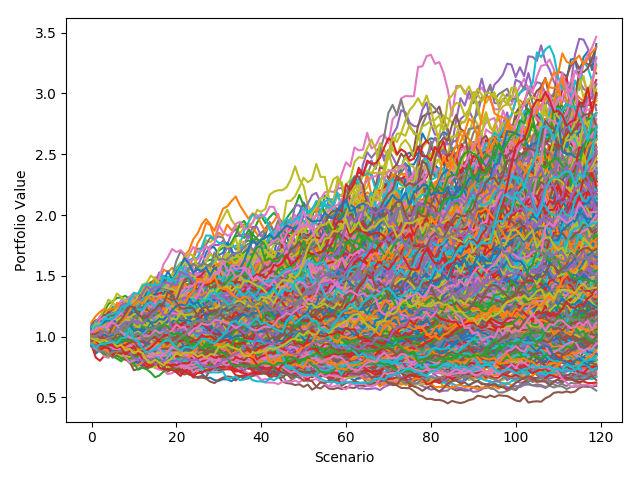

4.472824573516846


In [23]:
# Using matplotlib is surprisingly fast. Takes 3 s. 
# Issues with plot interactivity: can't see y value. Need to figure this one out.
import matplotlib
matplotlib.use('nbagg')  
import matplotlib.pyplot as plt
from matplotlib import rcParams
rcParams.update({'figure.autolayout': True})

start=time.time()
fig = plt.figure()
ax = fig.add_subplot(111)
_ =ax.plot(Test)
#_ = ax.set_yticklabels(['{:,.1%}'.format(y) for y in ax.get_yticks()]) # y doesn't get displayed on hover
_ = plt.xlabel('Scenario')
_ = plt.ylabel('Portfolio Value')
fig.show()
end=time.time()
print(end-start)

## Plotting histograms of scenario returns 

In [24]:
# Histogram

px.histogram(ResDF,x='Vt',histnorm='probability').update_layout(
    title='Histogram of 10-year return scenarios',
    xaxis=dict(title='10-year portfolio return',tickformat='.1%'),
    yaxis =dict(title='Percentage of scenarios',tickformat='.1%' ))

In [25]:
# Cumulative density function
x = ResDF['Vt']
pdata = go.Histogram(x=x,histnorm='probability',
            autobinx=False,xbins=dict(start=min(x),end=max(x),size=0.05),
                            cumulative_enabled=True)
pL = go.Layout(title='Cumulative Histogram of 10-year return scenarios',
    xaxis=dict(title='10-year portfolio return',tickformat='.1%'),
    yaxis =dict(title='Cumulative simulated probability',tickformat='.1%' ))

go.Figure(data=pdata,layout=pL)

## Table of values and scenario probability

Need to present stats like median return, first quartile return etc, but also probability of losing money, probability of doubling your money, worst case scenario, best case etc.

In [26]:
FinalVt = ResDF.loc[ResDF['Month']==THorizon-1,:]['Vt']
FinalVt.min(),FinalVt.max()
  
nbins=100
cf = ss.cumfreq(FinalVt,numbins=nbins)    # Cumulative counts

cprob = cf.cumcount/cf.cumcount[-1]       # Empirical CDF

ul= np.array([cf.lowerlimit+(i+1)*cf.binsize 
              for i in range(cf.cumcount.size)]) # Bin upper limits

cdf = pd.DataFrame({'BinUpperLimit':ul,'CumulativeProb':cprob})

cdf.head()
cdf.tail()
px.line(cdf,x='BinUpperLimit',y='CumulativeProb')

(0.556211087363319, 3.4650890171465183)

,BinUpperLimit,CumulativeProb
0,0.570902,0.001
1,0.600285,0.002
2,0.629668,0.005
3,0.659050,0.006
4,0.688433,0.010


,BinUpperLimit,CumulativeProb
95,3.362250,0.996
96,3.391633,0.998
97,3.421015,0.999
98,3.450398,0.999
99,3.479780,1.000
